# Linear Regression - Project 

## Imports
** Import pandas, numpy, matplotlib,and seaborn. Then set %matplotlib inline 
**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

## Get the Data

In [2]:
data = pd.read_csv("USBES_V2.csv")

In [3]:
data.head()

,Year,DOY,TIMESTAMP_END,Hour,NEE,H,LE,FCH4_mean,FCH4_median,USTAR,...,WS_F,LE_F_ANN,NEE_F_ANN,FCH4_F_ANN_median,FCH4_F_ANN_mean,FCH4_uncertainty,WD_vec_avg,WD_unit_vec_avg,WS_vec_avg,FCH4_daily_percent_NaN
0,2013,1,2.013010e+11,12.00,NaN,NaN,NaN,NaN,NaN,NaN,...,8.042128,-0.048325,0.036802,3.790118,3.674291,10.792827,NaN,NaN,NaN,97.916667
1,2013,2,2.013010e+11,11.75,NaN,NaN,NaN,NaN,NaN,NaN,...,5.820021,-0.045757,0.038331,3.337872,3.326435,13.366958,NaN,NaN,NaN,100.000000
2,2013,3,2.013010e+11,11.75,NaN,NaN,NaN,NaN,NaN,NaN,...,5.095521,-0.051923,0.039040,3.025617,3.035218,11.193800,NaN,NaN,NaN,100.000000
3,2013,4,2.013010e+11,11.75,NaN,NaN,NaN,NaN,NaN,NaN,...,7.168146,-0.110798,0.057143,2.998907,3.011057,9.488279,NaN,NaN,NaN,100.000000
4,2013,5,2.013011e+11,11.75,NaN,NaN,NaN,NaN,NaN,NaN,...,8.727687,-0.043231,0.043246,3.540202,3.500243,7.103705,NaN,NaN,NaN,100.000000


In [4]:
data.describe()

,Year,DOY,TIMESTAMP_END,Hour,NEE,H,LE,FCH4_mean,FCH4_median,USTAR,...,WS_F,LE_F_ANN,NEE_F_ANN,FCH4_F_ANN_median,FCH4_F_ANN_mean,FCH4_uncertainty,WD_vec_avg,WD_unit_vec_avg,WS_vec_avg,FCH4_daily_percent_NaN
count,1095.00000,1095.000000,1.095000e+03,1095.000000,714.000000,720.000000,714.000000,658.000000,724.000000,735.000000,...,1095.000000,1095.000000,1095.000000,1095.000000,1095.000000,1095.000000,736.000000,736.000000,736.000000,1095.000000
mean,2014.00000,183.000000,2.014067e+11,11.750228,-0.131297,9.689583,3.105496,11.815109,11.056434,0.322949,...,4.083400,4.125695,-0.073712,8.950289,9.001909,5.711590,139.637074,142.098538,3.632360,53.407534
std,0.81687,105.414174,8.175986e+07,0.007555,0.532602,28.729375,7.176301,12.319651,12.009388,0.258222,...,2.081228,9.726078,0.364632,11.070027,11.219292,3.752583,103.790981,103.671722,2.255169,40.388964
min,2013.00000,1.000000,2.013010e+11,11.750000,-3.175700,-55.086300,-30.684000,-1.702000,-8.670000,0.039913,...,0.143750,-4.531783,-2.159849,-2.893000,-1.090248,0.287088,1.108353,0.212688,0.043074,0.000000
25%,2013.00000,92.000000,2.013100e+11,11.750000,-0.332267,-8.332420,-0.147735,1.189845,1.360500,0.176787,...,2.573698,-0.063245,-0.077691,0.969956,0.974445,2.343132,51.901238,53.289408,1.993399,10.416667
50%,2014.00000,183.000000,2.014070e+11,11.750000,-0.025859,0.249946,0.585756,8.741221,8.004750,0.269269,...,3.634812,0.351734,0.017661,2.945374,2.977257,5.283165,96.255130,100.850164,3.181171,50.000000
75%,2015.00000,274.000000,2.015040e+11,11.750000,0.153581,20.583720,3.466877,17.893964,16.190875,0.388861,...,5.168896,2.828499,0.105228,12.471730,12.513602,8.362776,223.579764,230.739562,4.849250,100.000000
max,2015.00000,365.000000,2.015123e+11,12.000000,3.042600,135.495759,63.532933,57.809488,58.385000,2.788926,...,12.750687,61.688257,1.181374,53.319000,55.846072,22.488967,359.965948,359.935556,12.767547,100.000000


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1095 entries, 0 to 1094
Data columns (total 54 columns):
Year                      1095 non-null int64
DOY                       1095 non-null int64
TIMESTAMP_END             1095 non-null float64
Hour                      1095 non-null float64
NEE                       714 non-null float64
H                         720 non-null float64
LE                        714 non-null float64
FCH4_mean                 658 non-null float64
FCH4_median               724 non-null float64
USTAR                     735 non-null float64
SW_IN                     1074 non-null float64
SW_OUT                    1073 non-null float64
NETRAD                    1073 non-null float64
PPFD_IN                   1074 non-null float64
PPFD_OUT                  1074 non-null float64
VPD                       1073 non-null float64
RH                        1073 non-null float64
PA                        731 non-null float64
TA                        1073 non-null 

In [6]:
data.dropna(axis=0, how='any', inplace=True)

**Let's explore these types of relationships across the entire data set.**

In [29]:
sns.pairplot(data)

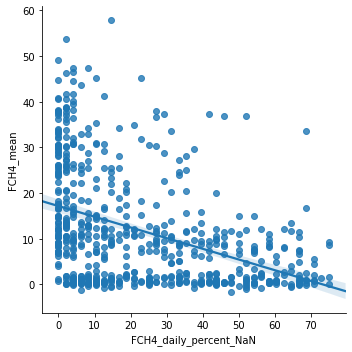

In [28]:
sns.lmplot(x='FCH4_daily_percent_NaN',y='FCH4_mean',data=data)

## Training and Testing Data

In [13]:
data.columns

Index(['Year', 'DOY', 'TIMESTAMP_END', 'Hour', 'NEE', 'H', 'LE', 'FCH4_mean',
       'FCH4_median', 'USTAR', 'SW_IN', 'SW_OUT', 'NETRAD', 'PPFD_IN',
       'PPFD_OUT', 'VPD', 'RH', 'PA', 'TA', 'TS_1', 'TS_2', 'TS_3', 'G_1',
       'SWC_1', 'SWC_2', 'GPP_NT', 'RECO_NT', 'GPP_DT', 'RECO_DT', 'NEE_F',
       'H_F', 'LE_F', 'FCH4_F', 'SW_IN_F', 'SW_OUT_F', 'LW_IN_F', 'NETRAD_F',
       'PPFD_IN_F', 'PPFD_OUT_F', 'VPD_F', 'RH_F', 'PA_F', 'TA_F', 'P_F',
       'WS_F', 'LE_F_ANN', 'NEE_F_ANN', 'FCH4_F_ANN_median', 'FCH4_F_ANN_mean',
       'FCH4_uncertainty', 'WD_vec_avg', 'WD_unit_vec_avg', 'WS_vec_avg',
       'FCH4_daily_percent_NaN'],
      dtype='object')

In [15]:
y = data['FCH4_mean']

In [16]:
X = data[['Year', 'DOY', 'TIMESTAMP_END', 'Hour', 'NEE', 'H', 'LE', 
       'FCH4_median', 'USTAR', 'SW_IN', 'SW_OUT', 'NETRAD', 'PPFD_IN',
       'PPFD_OUT', 'VPD', 'RH', 'PA', 'TA', 'TS_1', 'TS_2', 'TS_3', 'G_1',
       'SWC_1', 'SWC_2', 'GPP_NT', 'RECO_NT', 'GPP_DT', 'RECO_DT', 'NEE_F',
       'H_F', 'LE_F', 'FCH4_F', 'SW_IN_F', 'SW_OUT_F', 'LW_IN_F', 'NETRAD_F',
       'PPFD_IN_F', 'PPFD_OUT_F', 'VPD_F', 'RH_F', 'PA_F', 'TA_F', 'P_F',
       'WS_F', 'LE_F_ANN', 'NEE_F_ANN', 'FCH4_F_ANN_median', 'FCH4_F_ANN_mean',
       'FCH4_uncertainty', 'WD_vec_avg', 'WD_unit_vec_avg', 'WS_vec_avg',
       'FCH4_daily_percent_NaN']]

** Use model_selection.train_test_split from sklearn to split the data into training and testing sets. Set test_size=0.3 and random_state=101**

In [17]:
from sklearn.model_selection import train_test_split

In [18]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

## Training the Model

Now its time to train our model on our training data!

** Import LinearRegression from sklearn.linear_model **

In [19]:
from sklearn.linear_model import LinearRegression

**Create an instance of a LinearRegression() model named lm.**

In [20]:
lm = LinearRegression()

** Train/fit lm on the training data.**

In [21]:
lm.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

**Print out the coefficients of the model**

In [22]:
# The coefficients
print('Coefficients: \n', lm.coef_)

Coefficients: 
 [ 1.63669984e+00  3.39404622e-04 -1.60896362e-08  1.23759391e-05
 -9.62742377e-03  1.85421299e-03 -4.34481531e-02  3.56985010e-01
 -2.78840235e-01 -8.62608327e-02  8.66313356e-02  6.05150276e-01
 -1.81152728e-01  3.81150893e-01  5.63743649e-01  7.33481697e-01
 -1.17634702e+00 -1.25080926e-01  4.62296193e-02  2.65797857e-01
 -2.82090973e-01 -4.21753771e-03  3.02636804e-03 -3.04969623e-03
 -2.00081970e+02  2.00087195e+02  2.05649984e-03  1.30783138e-02
 -2.00346280e+02 -2.04792650e-03 -1.30646766e-01 -1.05048799e-01
 -1.82308568e-01 -8.41411108e-02 -1.05977529e-03 -6.04607083e-01
  3.09753357e-01 -3.82941453e-01 -9.43080101e-01 -7.52991802e-01
  1.17310514e+00  1.37340203e-01  8.71145545e-01  7.02477784e-02
  1.75922190e-01  4.18505290e-01 -4.92265622e-01  1.25681036e+00
 -5.77638648e-02 -1.18737869e-03  8.23591154e-04 -4.83950160e-02
 -1.35510350e-04]


## Predicting Test Data
Now that we have fit our model, let's evaluate its performance by predicting off the test values!

** Use lm.predict() to predict off the X_test set of the data.**

In [23]:
predictions = lm.predict( X_test)

** Create a scatterplot of the real test values versus the predicted values. **

Text(0, 0.5, 'Predicted Y')

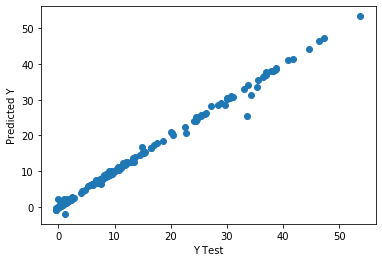

In [24]:
plt.scatter(y_test,predictions)
plt.xlabel('Y Test')
plt.ylabel('Predicted Y')

## Evaluating the Model

Let's evaluate our model performance by calculating the residual sum of squares and the explained variance score (R^2).

** Calculate the Mean Absolute Error, Mean Squared Error, and the Root Mean Squared Error. Refer to the lecture or to Wikipedia for the formulas**

In [25]:
# calculate these metrics by hand!
from sklearn import metrics

print('MAE:', metrics.mean_absolute_error(y_test, predictions))
print('MSE:', metrics.mean_squared_error(y_test, predictions))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predictions)))

MAE: 0.32780775192673955
MSE: 0.6371993296663067
RMSE: 0.7982476618608455


## Residuals

You should have gotten a very good model with a good fit. Let's quickly explore the residuals to make sure everything was okay with our data. 

**Plot a histogram of the residuals and make sure it looks normally distributed. Use either seaborn distplot, or just plt.hist().**

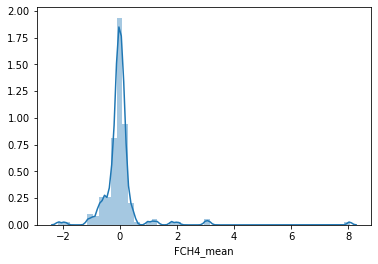

In [26]:
sns.distplot((y_test-predictions),bins=50);

## Conclusion


In [27]:
coeffecients = pd.DataFrame(lm.coef_,X.columns)
coeffecients.columns = ['Coeffecient']
coeffecients

,Coeffecient
Year,1.636700e+00
DOY,3.394046e-04
TIMESTAMP_END,-1.608964e-08
Hour,1.237594e-05
NEE,-9.627424e-03
H,1.854213e-03
LE,-4.344815e-02
FCH4_median,3.569850e-01
USTAR,-2.788402e-01
SW_IN,-8.626083e-02
